In [1]:
# Import packages 
import numpy as np
import pandas as pd
import os
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.pyplot import xticks
# from kmodes.kprototypes import KPrototypes
# from kmodes.kmodes import KModes
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn import preprocessing
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn import svm

# import pymysql
import matplotlib
from sklearn.utils import resample
from sklearn.feature_selection import chi2

### Avoid scientific format of number display
pd.options.display.float_format = '{:.2f}'.format 


from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
np.set_printoptions(threshold=np.inf)

In [114]:
## write functions for gains table
def gains_table(model,test,hextest):
    df_prep = pd.DataFrame(columns = ['actual','pred'])
    df_prep['actual'] = test['PROGRAM_PART']
    df_prep['pred'] =model.predict(hextest).as_data_frame()
    df_prep = df_prep.sort_values(by='pred',ascending=False)
    df_prep['row_id'] = range(0,0+len(df_prep))
    df_prep.head()

    df_prep['decile'] = (df_prep['row_id'] / (len(df_prep)/10)).astype(int)
    df_prep.loc[df_prep['decile'] == 10] =9
    df_prep['decile'].value_counts()

    # Create gains table
    gains = df_prep.groupby('decile')['actual'].agg(['count','sum'])
    gains.columns = ['count','actual']
    gains

    gains['non_actual'] = gains['count'] - gains['actual']
    gains['cum_count'] = gains['count'].cumsum()
    gains['cum_actual'] = gains['actual'].cumsum()
    gains['cum_non_actual'] = gains['non_actual'].cumsum()
    gains['percent_cum_actual'] = (gains['cum_actual'] / np.max(gains['cum_actual'])).round(2)
    gains['percent_cum_non_actual'] = (gains['cum_non_actual'] / np.max(gains['cum_non_actual'])).round(2)
    gains['if_random'] = np.max(gains['cum_actual']) /10
    gains['if_random'] = gains['if_random'].cumsum()
    gains['lift'] = (gains['cum_actual'] / gains['if_random']).round(2)
    gains['K_S'] = np.abs( gains['percent_cum_actual'] - gains['percent_cum_non_actual']  ) * 100 
    gains['gain'] = (gains['cum_actual'] / gains['cum_count']*100).round(2)
    return(gains)

In [ ]:
## write functions for ROC AUC curve
def ROC_AUC(my_result,df,target):
    from sklearn.metrics import roc_curve,auc
    from sklearn.metrics import average_precision_score
    from sklearn.metrics import precision_recall_curve
    import matplotlib.pyplot as plt

    # ROC
    y_actual = df[target].as_data_frame()
    y_pred = my_result.predict(df).as_data_frame()['predict']
    fpr = list()
    tpr = list()
    roc_auc = list()
    fpr,tpr,_ = roc_curve(y_actual,y_pred)
    roc_auc = auc(fpr,tpr)
    
    # Precision-Recall
    average_precision = average_precision_score(y_actual,y_pred)
    
    # plotting
    plt.figure(figsize=(10,4))

    # ROC
    plt.subplot(1,2,1)
    plt.plot(fpr,tpr,color='darkorange',lw=2,label='ROC curve (area=%0.2f)' % roc_auc)
    plt.plot([0,1],[0,1],color='navy',lw=3,linestyle='--')
    plt.xlim([0.0,1.0])
    plt.ylim([0.0,1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic: AUC={0:0.4f}'.format(roc_auc))
    plt.legend(loc='lower right')

    # Precision-Recall
    plt.subplot(1,2,2)
    precision,recall,_ = precision_recall_curve(y_actual,y_pred)
    plt.step(recall,precision,color='b',alpha=0.2,where='post')
    plt.fill_between(recall,precision,step='post',alpha=0.2,color='b')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0,1.05])
    plt.xlim([0.0,1.0])
    plt.title('Precision-Recall curve: PR={0:0.4f}'.format(average_precision))
    plt.show()

In [ ]:
## write functions for variable importance
def VarImp(model_name):
    
    from sklearn.metrics import roc_curve,auc
    from sklearn.metrics import average_precision_score
    from sklearn.metrics import precision_recall_curve
    import matplotlib.pyplot as plt
    
    # plot the variable importance
    plt.rcdefaults()
    variables = model_name._model_json['output']['variable_importances']['variable']
    y_pos = np.arange(len(variables))
    fig, ax = plt.subplots(figsize = (6,len(variables)/2))
    scaled_importance = model_name._model_json['output']['variable_importances']['scaled_importance']
    ax.barh(y_pos,scaled_importance,align='center',color='green')
    ax.set_yticks(y_pos)
    ax.set_yticklabels(variables)
    ax.invert_yaxis()
    ax.set_xlabel('Scaled Importance')
    ax.set_title('Variable Importance')
    plt.show()

In [2]:
import time
import resource 

# Merge two datasets

In [ ]:
df_big = pd.read_csv('EXTRACT_COLUMBIA_UNIVERSITY_EBILLS_10052020.csv')
df_small = pd.read_csv('EXTRACT_COLUMBIA_UNIVERSITY_10052020.csv')

In [ ]:
df_big['TO_DATE'] = pd.to_datetime(df_big['TO_DATE'])
df_big['FR_DATE'] = pd.to_datetime(df_big['FR_DATE'])
df_big['MDATE'] = pd.to_datetime(df_big['MDATE'])
df_big['FR_YEAR'] = pd.DatetimeIndex(df_big['FR_DATE']).year

In [ ]:
avg_consump = df_big.groupby(['MASKED_ID','FR_YEAR'])['EL_CONSUMP'].mean().reset_index()
avg_consump.columns = ['MASKED_ID','FR_YEAR','AVG_EL_CONSUMP']
avg_consump_pivot = avg_consump.pivot_table(index='MASKED_ID', 
                                            columns='FR_YEAR',values = 'AVG_EL_CONSUMP', 
                                            aggfunc = 'mean',fill_value=0)

In [ ]:
avg_consump_pivot.columns = ['MASKED_ID','2014_AVG_EL_CONSUMP',
                            '2015_AVG_EL_CONSUMP','2016_AVG_EL_CONSUMP','2017_AVG_EL_CONSUMP',
                            '2018_AVG_EL_CONSUMP','2019_AVG_EL_CONSUMP','2020_AVG_EL_CONSUMP']

In [ ]:
avg_bill = df_big.groupby(['MASKED_ID','FR_YEAR'])['EL_BILL_AMT'].mean().reset_index()
avg_bill.columns = ['MASKED_ID','FR_YEAR','AVG_EL_BILL_AMT']
avg_bill_pivot = avg_bill.pivot_table(index='MASKED_ID', 
                                            columns='FR_YEAR',values = 'AVG_EL_BILL_AMT', 
                                            aggfunc = 'mean',fill_value=0)


In [ ]:
avg_bill_pivot.columns = ['MASKED_ID','2014_AVG_BILL_CONSUMP',
                            '2015_AVG_BILL_CONSUMP','2016_AVG_BILL_CONSUMP','2017_AVG_BILL_CONSUMP',
                            '2018_AVG_BILL_CONSUMP','2019_AVG_BILL_CONSUMP','2020_AVG_BILL_CONSUMP']

In [ ]:
df_big_shrink = avg_bill_pivot.merge(avg_consump_pivot,on='MASKED_ID',how='left')

In [ ]:
df_processed = df_small.merge(df_big_shrink,on='MASKED_ID',how = 'left')

In [ ]:
df_11_11_processed = df_processed.copy()
df_11_11_processed.drop(['GSAC','GSSC','ACCT_STATUS','SC_HEAT','BLDG_UNITS','GEO_NETWK_CODE','BLOCK','LOT','NAICS',
                      'NETWORK_CODE','SADD_SORT_PS','ANNUALIZED_THERMS'],axis = 1, inplace=True)

In [ ]:
df_11_11_processed = df_11_11_processed.drop(df_11_11_processed[df_11_11_processed['CUST_SEGMENT'] == 'Small Multi-Family - Common Area'].index)
df_11_11_processed = df_11_11_processed.drop(df_11_11_processed[df_11_11_processed['CUST_SEGMENT'] == 'Large Multi-Family - Common Area'].index)
df_11_11_processed = df_11_11_processed.drop(df_11_11_processed[df_11_11_processed['CUST_SEGMENT'] == 'Small Multi-Family - Res'].index)
df_11_11_processed = df_11_11_processed.drop(df_11_11_processed[df_11_11_processed['CUST_SEGMENT'] == 'Large Multi-Family - Res'].index)
df_11_11_processed['CUST_SEGMENT']=df_11_11_processed['CUST_SEGMENT'].fillna('Other')
df_11_11_processed.to_csv('df_11_11_processed.csv')


In [263]:
df_11_11_processed = pd.read_csv('df_11_11_processed.csv')

## Data transformation and feature engineering

In [264]:
df_11_11_processed['MASKED_ID']=df_11_11_processed['MASKED_ID'].astype('object')

df_11_11_processed.loc[df_11_11_processed['ELSC'].
                           isin((df_11_11_processed['ELSC'].value_counts()[df_11_11_processed['ELSC'].value_counts() < 300]).index), 'ELSC'] = 'Other'

df_11_11_processed['ELSC']=df_11_11_processed['ELSC'].astype('category')

df_11_11_processed['ELAC']=df_11_11_processed['ELSC'].astype('category')

df_11_11_processed['PROGRAM_PART'] = np.where(df_11_11_processed['PROGRAM_PART'] == 'Y', 1, 0)

df_11_11_processed.drop(['Unnamed: 0','Unnamed: 0.1'],inplace=True,axis=1)

df_11_11_processed.loc[df_11_11_processed['CUST_SEGMENT'] == 'Restaurants', 'CUST_SEGMENT'] = 'Restaurant'

In [272]:
df_11_11_processed_new = df_11_11_processed.copy()
df_11_11_processed_new['TURN_ON_DT'] = pd.to_datetime(df_11_11_processed_new['TURN_ON_DT'])

df_11_11_processed_new['day_since'] = (df_11_11_processed_new['TURN_ON_DT'].max()-
                                       df_11_11_processed_new['TURN_ON_DT']).dt.days

df_11_11_processed_new['day_since'] = df_11_11_processed_new['day_since'].astype('int')

### Feature engineering

In [273]:
middle1 = df_11_11_processed_new.groupby('TOWN')['2016_AVG_BILL_CONSUMP'].mean().reset_index()
middle1.columns = ['TOWN','TOWN_AVG_2016']
middle2 = df_11_11_processed_new.groupby('TOWN')['2017_AVG_BILL_CONSUMP'].mean().reset_index()
middle2.columns = ['TOWN','TOWN_AVG_2017']
middle3 = df_11_11_processed_new.groupby('TOWN')['2018_AVG_BILL_CONSUMP'].mean().reset_index()
middle3.columns = ['TOWN','TOWN_AVG_2018']
middle4 = df_11_11_processed_new.groupby('TOWN')['2019_AVG_BILL_CONSUMP'].mean().reset_index()
middle4.columns = ['TOWN','TOWN_AVG_2019']
middle5 = df_11_11_processed_new.groupby('TOWN')['2020_AVG_BILL_CONSUMP'].mean().reset_index()
middle5.columns = ['TOWN','TOWN_AVG_2020']

In [274]:
df_11_11_processed_new = df_11_11_processed_new.merge(middle1,on='TOWN',how='left')
df_11_11_processed_new['AVG_2016_BILL_MULTIPLES'] = df_11_11_processed_new['2016_AVG_BILL_CONSUMP']/df_11_11_processed_new['TOWN_AVG_2016']

df_11_11_processed_new = df_11_11_processed_new.merge(middle2,on='TOWN',how='left')
df_11_11_processed_new['AVG_2017_BILL_MULTIPLES'] = df_11_11_processed_new['2017_AVG_BILL_CONSUMP']/df_11_11_processed_new['TOWN_AVG_2017']

df_11_11_processed_new = df_11_11_processed_new.merge(middle3,on='TOWN',how='left')
df_11_11_processed_new['AVG_2018_BILL_MULTIPLES'] = df_11_11_processed_new['2018_AVG_BILL_CONSUMP']/df_11_11_processed_new['TOWN_AVG_2018']

df_11_11_processed_new = df_11_11_processed_new.merge(middle4,on='TOWN',how='left')
df_11_11_processed_new['AVG_2019_BILL_MULTIPLES'] = df_11_11_processed_new['2019_AVG_BILL_CONSUMP']/df_11_11_processed_new['TOWN_AVG_2019']

df_11_11_processed_new = df_11_11_processed_new.merge(middle5,on='TOWN',how='left')
df_11_11_processed_new['AVG_2020_BILL_MULTIPLES'] = df_11_11_processed_new['2020_AVG_BILL_CONSUMP']/df_11_11_processed_new['TOWN_AVG_2020']



In [275]:
df_11_11_processed_new.loc[df_11_11_processed_new['TOWN'].
                           isin((df_11_11_processed_new['TOWN'].value_counts()
                                 [df_11_11_processed_new['TOWN'].value_counts() < 3000]).index), 'TOWN'] = 'Other'


In [315]:
df_11_11_processed_new['ZIP'] = df_11_11_processed_new['ZIP'].astype(str)
df_11_11_processed_new['ZIP_FIRST4'] = (df_11_11_processed_new['ZIP'].str.slice(stop=4).astype(int))
df_11_11_processed_new.loc[df_11_11_processed_new['ZIP_FIRST4'].isin((df_11_11_processed_new['ZIP_FIRST4'].value_counts()
                                 [df_11_11_processed_new['ZIP_FIRST4'].value_counts() < 100]).index), 'ZIP_FIRST4'] = 'Other'
df_11_11_processed_new['ZIP_FIRST4'] = df_11_11_processed_new['ZIP_FIRST4'].astype('category')

In [ ]:
df_11_11_processed_new.info()

In [10]:
middle1.head()

,TOWN,TOWN_AVG_2016
0,ARDSLEY NY,6319.30
1,ARDSLEY-HDSN NY,397.00
2,ARMONK NY,8940.56
3,ASTORIA NY,2854.50
4,BAYSIDE NY,3559.87


In [29]:
df_11_11_processed_new.head()

,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since,TOWN_AVG_2016,AVG_2016_BILL_MULTIPLES,TOWN_AVG_2017,AVG_2017_BILL_MULTIPLES,TOWN_AVG_2018,AVG_2018_BILL_MULTIPLES,TOWN_AVG_2019,AVG_2019_BILL_MULTIPLES,TOWN_AVG_2020,AVG_2020_BILL_MULTIPLES
0,100005919400,ACTIVE,9,NEW YORK NY,10011,40703151.00,74014430.00,2018-04-11,192.00,MN,881149,170,397,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,11282.85,14935.75,11433.74,0.00,0.00,0.00,0.00,66577.78,90945.45,63350.00,892,1045.26,0.00,1217.30,0.00,1222.25,9.23,1321.92,11.30,1314.67,8.70
1,100005919442,ACTIVE,9,YONKERS NY,10701,40932053.00,73870683.00,2018-03-16,15.84,WS,61368,12,364,0,Miscellaneous/Entertainment,0.00,0.00,0.00,0.00,435.11,938.57,859.52,0.00,0.00,0.00,0.00,2002.00,5556.00,5078.25,918,473.27,0.00,536.48,0.00,542.57,0.80,596.01,1.57,575.06,1.49
2,100005919497,ACTIVE,2,MOUNT VERNON NY,10550,40911425.00,73842656.00,2018-04-30,0.00,WS,7773,0,364,0,Small Office,0.00,0.00,0.00,0.00,151.67,162.77,161.87,0.00,0.00,0.00,0.00,516.62,706.83,697.88,873,338.34,0.00,380.19,0.00,418.31,0.36,431.26,0.38,418.14,0.39
3,100005919510,ACTIVE,2,NEW ROCHELLE NY,10801,40913582.00,73789472.00,2019-08-13,1.62,WS,1152,1,365,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,0.00,43.45,50.85,0.00,0.00,0.00,0.00,0.00,57.60,112.50,403,348.85,0.00,421.03,0.00,424.23,0.00,473.54,0.09,480.79,0.11
4,100005919513,ACTIVE,9,MOUNT VERNON NY,10550,40899681.00,73821127.00,2018-07-20,20.80,WS,29441,20,364,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,424.27,851.30,817.66,0.00,0.00,0.00,0.00,1493.33,2480.00,2370.00,792,338.34,0.00,380.19,0.00,418.31,1.01,431.26,1.97,418.14,1.96


In [33]:
# predictors = ['ELAC', 'ELSC', 'ZIP_FIRST4', 'HI_DMD_1YR','AVGOFBILLED_DMD',
#               'E_PRO_PER', 'day_since', 'AVG_2016_BILL_MULTIPLES', 'AVG_2017_BILL_MULTIPLES',
#               'AVG_2018_BILL_MULTIPLES','AVG_2019_BILL_MULTIPLES','AVG_2020_BILL_MULTIPLES']

# target = 'PROGRAM_PART'
df = df_11_11_processed_new[['ELAC', 'ELSC', 'ZIP_FIRST4', 'HI_DMD_1YR','AVGOFBILLED_DMD',
              'E_PRO_PER', 'day_since', 'AVG_2016_BILL_MULTIPLES', 'AVG_2017_BILL_MULTIPLES',
              'AVG_2018_BILL_MULTIPLES','AVG_2019_BILL_MULTIPLES','AVG_2020_BILL_MULTIPLES',
                           'PROGRAM_PART']]

In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 277919 entries, 0 to 277918
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   ELAC                     277919 non-null  object  
 1   ELSC                     277919 non-null  object  
 2   ZIP_FIRST4               277919 non-null  category
 3   HI_DMD_1YR               277919 non-null  float64 
 4   AVGOFBILLED_DMD          277919 non-null  int64   
 5   E_PRO_PER                277919 non-null  int64   
 6   day_since                277919 non-null  int64   
 7   AVG_2016_BILL_MULTIPLES  277915 non-null  float64 
 8   AVG_2017_BILL_MULTIPLES  277916 non-null  float64 
 9   AVG_2018_BILL_MULTIPLES  277916 non-null  float64 
 10  AVG_2019_BILL_MULTIPLES  277916 non-null  float64 
 11  AVG_2020_BILL_MULTIPLES  277919 non-null  float64 
 12  PROGRAM_PART             277919 non-null  int64   
dtypes: category(1), float64(6), int64(4), object

In [60]:
df = pd.get_dummies(df, columns = ['ELAC','ELSC','ZIP_FIRST4'], 
                                        prefix=['ELAC','ELSC','ZIP_FIRST4'],drop_first=True)

In [50]:
df['AVG_2016_BILL_MULTIPLES'] = df['AVG_2016_BILL_MULTIPLES'].fillna(0)
df['AVG_2017_BILL_MULTIPLES'] = df['AVG_2017_BILL_MULTIPLES'].fillna(0)
df['AVG_2018_BILL_MULTIPLES'] = df['AVG_2018_BILL_MULTIPLES'].fillna(0)
df['AVG_2019_BILL_MULTIPLES'] = df['AVG_2019_BILL_MULTIPLES'].fillna(0)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

In [51]:
df.isna().sum()

ELAC                       0
ELSC                       0
ZIP_FIRST4                 0
HI_DMD_1YR                 0
AVGOFBILLED_DMD            0
E_PRO_PER                  0
day_since                  0
AVG_2016_BILL_MULTIPLES    0
AVG_2017_BILL_MULTIPLES    0
AVG_2018_BILL_MULTIPLES    0
AVG_2019_BILL_MULTIPLES    0
AVG_2020_BILL_MULTIPLES    0
PROGRAM_PART               0
dtype: int64

### Variable inflation factor

In [165]:
df_11_11_processed_new.columns

Index(['MASKED_ID', 'ELAC', 'ELSC', 'TOWN', 'ZIP', 'LATITUDE', 'LONGITUDE',
       'TURN_ON_DT', 'HI_DMD_1YR', 'Boro', 'ANNUALIZED_KWH', 'AVGOFBILLED_DMD',
       'E_PRO_PER', 'PROGRAM_PART', 'CUST_SEGMENT', '2014_AVG_BILL_CONSUMP',
       '2015_AVG_BILL_CONSUMP', '2016_AVG_BILL_CONSUMP',
       '2017_AVG_BILL_CONSUMP', '2018_AVG_BILL_CONSUMP',
       '2019_AVG_BILL_CONSUMP', '2020_AVG_BILL_CONSUMP', '2014_AVG_EL_CONSUMP',
       '2015_AVG_EL_CONSUMP', '2016_AVG_EL_CONSUMP', '2017_AVG_EL_CONSUMP',
       '2018_AVG_EL_CONSUMP', '2019_AVG_EL_CONSUMP', '2020_AVG_EL_CONSUMP',
       'day_since', 'ZIP_FIRST4', 'TOWN_AVG_2016', 'AVG_2016_BILL_MULTIPLES',
       'TOWN_AVG_2017', 'AVG_2017_BILL_MULTIPLES', 'TOWN_AVG_2018',
       'AVG_2018_BILL_MULTIPLES', 'TOWN_AVG_2019', 'AVG_2019_BILL_MULTIPLES',
       'TOWN_AVG_2020', 'AVG_2020_BILL_MULTIPLES'],
      dtype='object')

In [178]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

df_vif = df_11_11_processed_new[['ELSC',
        'HI_DMD_1YR', 'ANNUALIZED_KWH', 'AVGOFBILLED_DMD', 'day_since', 'ZIP_FIRST4',
       'E_PRO_PER',  '2016_AVG_BILL_CONSUMP',
       '2017_AVG_BILL_CONSUMP', '2018_AVG_BILL_CONSUMP',
       '2019_AVG_BILL_CONSUMP', '2020_AVG_BILL_CONSUMP', '2016_AVG_EL_CONSUMP', '2017_AVG_EL_CONSUMP',
       '2018_AVG_EL_CONSUMP', '2019_AVG_EL_CONSUMP', '2020_AVG_EL_CONSUMP',
        'AVG_2016_BILL_MULTIPLES',
        'AVG_2017_BILL_MULTIPLES',
       'AVG_2018_BILL_MULTIPLES', 'AVG_2019_BILL_MULTIPLES',
       'AVG_2020_BILL_MULTIPLES']]

# df['AVG_2016_BILL_MULTIPLES'] = df['AVG_2016_BILL_MULTIPLES'].fillna(0)
# df['AVG_2017_BILL_MULTIPLES'] = df['AVG_2017_BILL_MULTIPLES'].fillna(0)
# df['AVG_2018_BILL_MULTIPLES'] = df['AVG_2018_BILL_MULTIPLES'].fillna(0)
# df['AVG_2019_BILL_MULTIPLES'] = df['AVG_2019_BILL_MULTIPLES'].fillna(0)

In [180]:
df_vif = pd.get_dummies(df_vif, columns = ['ELSC','ZIP_FIRST4'], 
                                        prefix=['ELSC','ZIP_FIRST4'],drop_first=True)

# df_vif['AVG_2016_BILL_MULTIPLES'] = df_vif['AVG_2016_BILL_MULTIPLES'].fillna(0)
# df_vif['AVG_2017_BILL_MULTIPLES'] = df_vif['AVG_2017_BILL_MULTIPLES'].fillna(0)
# df_vif['AVG_2018_BILL_MULTIPLES'] = df_vif['AVG_2018_BILL_MULTIPLES'].fillna(0)
# df_vif['AVG_2019_BILL_MULTIPLES'] = df_vif['AVG_2019_BILL_MULTIPLES'].fillna(0)

In [ ]:
df_vif.isna().sum()

In [182]:
trainvif, testvif = train_test_split(df_vif, test_size=0.30, random_state=0)

In [183]:
vif = pd.Series([variance_inflation_factor(trainvif.values,i)
                for i in range(trainvif.shape[1])],
               index=trainvif.columns)

In [184]:
vif 

HI_DMD_1YR                  6.43
ANNUALIZED_KWH            644.07
AVGOFBILLED_DMD            24.80
day_since                   1.39
E_PRO_PER                   9.78
2016_AVG_BILL_CONSUMP     123.01
2017_AVG_BILL_CONSUMP     172.34
2018_AVG_BILL_CONSUMP     125.60
2019_AVG_BILL_CONSUMP      78.80
2020_AVG_BILL_CONSUMP     127.26
2016_AVG_EL_CONSUMP        53.42
2017_AVG_EL_CONSUMP       112.25
2018_AVG_EL_CONSUMP        88.30
2019_AVG_EL_CONSUMP       204.14
2020_AVG_EL_CONSUMP       339.55
AVG_2016_BILL_MULTIPLES    63.68
AVG_2017_BILL_MULTIPLES    91.78
AVG_2018_BILL_MULTIPLES    91.37
AVG_2019_BILL_MULTIPLES   101.98
AVG_2020_BILL_MULTIPLES    81.58
ELSC_9                      1.76
ELSC_51                     1.13
ELSC_116                    1.02
ELSC_117                    1.01
ELSC_Other                  1.02
ZIP_FIRST4_1001             1.90
ZIP_FIRST4_1002             1.53
ZIP_FIRST4_1003             1.30
ZIP_FIRST4_1004             1.02
ZIP_FIRST4_1006             1.07
ZIP_FIRST4

## KNN Outlier Analysis

In [55]:
from pyod.models.knn import KNN

In [76]:
X_train1, X_test1 = train_test_split(df, test_size=0.30, random_state=0)

In [77]:
X_train1.shape
X_test1.shape

(194543, 58)

(83376, 58)

In [63]:
clf_name = 'KNN'
clf = KNN()
clf.fit(X_train1)

KNN(algorithm='auto', contamination=0.1, leaf_size=30, method='largest',
  metric='minkowski', metric_params=None, n_jobs=1, n_neighbors=5, p=2,
  radius=1.0)

In [64]:
y_test_pred = clf.predict(X_test1)
y_test_scores = clf.decision_function(X_test1)

In [ ]:
import matplotlib.pyplot as plt
plt.hist(y_test_scores, bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram with 'auto' bins")
plt.show()

In [70]:
pd.DataFrame(y_test_scores).describe()

,0
count,83376.00
mean,12.68
std,178.66
min,0.00
25%,2.27
50%,4.26
75%,10.11
max,44559.45


In [74]:
df_test = pd.DataFrame(X_test1)
df_test['score'] = y_test_scores
df_test['cluster'] = np.where(df_test['score']<20, 0, 1)
df_test['cluster'].value_counts()

0    73319
1    10057
Name: cluster, dtype: int64

In [78]:
from pyod.models.combination import aom, moa, average, maximization
from pyod.utils.utility import standardizer
X_train_norm, X_test_norm = standardizer(X_train1, X_test1)

In [ ]:
n_clf = 20
k_list = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 
 120, 130, 140, 150, 160, 170, 180, 190, 200]
# Just prepare data frames so we can store the model results
train_scores = np.zeros([X_train1.shape[0], n_clf])
test_scores = np.zeros([X_test1.shape[0], n_clf])
train_scores.shape
# Modeling
for i in range(n_clf):
    k = k_list[i]
    clf = KNN(n_neighbors=k, method='largest')
    clf.fit(X_train1)

    # Store the results in each column:
    train_scores[:, i] = clf.decision_scores_
    test_scores[:, i] = clf.decision_function(X_test_norm)

In [82]:
# Standardize result
train_scores_norm, test_scores_norm = standardizer(train_scores,test_scores)

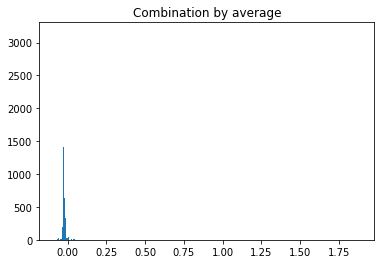

In [83]:
y_by_average = average(test_scores_norm)
import matplotlib.pyplot as plt
A=plt.hist(y_by_average, bins='auto') # arguments are passed to np.histogram
B=plt.title("Combination by average")
plt.show()

In [84]:
pd.DataFrame(y_by_average).describe()

,0
count,83376.00
mean,-0.02
std,0.01
min,-0.08
25%,-0.03
50%,-0.02
75%,-0.02
max,1.88


In [200]:
df_test2 = pd.DataFrame(X_test1).copy()
df_test2['y_by_average_score'] = y_by_average
df_test2['y_by_average_cluster'] = np.where(df_test2['y_by_average_score']<0, 0, 1)
df_test2['y_by_average_cluster'].value_counts()     

0    80884
1     2492
Name: y_by_average_cluster, dtype: int64

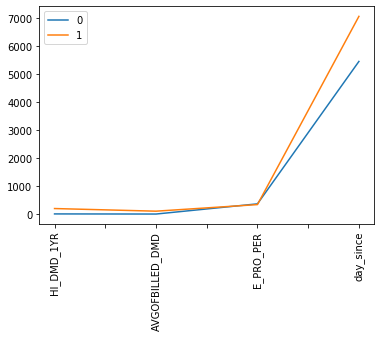

In [104]:
try2 = df_test2.groupby('y_by_average_cluster').mean()
try2 = try2.iloc[:,:4]
# plt.figure(figsize=(20,10))
c= try2.iloc[0,:].plot()
c= try2.iloc[1,:].plot()
c=plt.legend()
c=plt.xticks(rotation = 90)

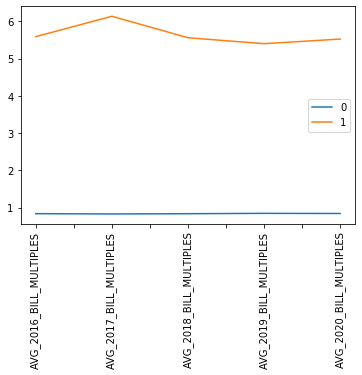

In [97]:
try3 = df_test2.groupby('y_by_average_cluster').mean()
try3 = try3.iloc[:,4:9]
# plt.figure(figsize=(20,10))
c= try3.iloc[0,:].plot()
c= try3.iloc[1,:].plot()
c=plt.legend()
c=plt.xticks(rotation = 90)

In [317]:
normal = df_test2[df_test2['y_by_average_cluster']==0]
normal_cus = df_11_11_processed_new.iloc[normal.index] 
# normal_cus.info()

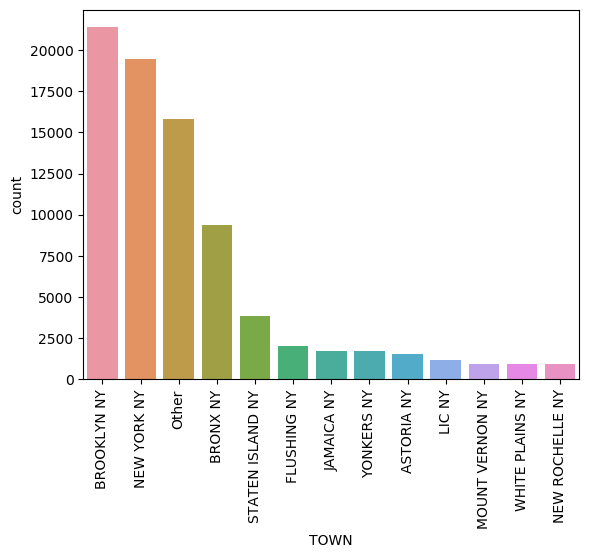

In [313]:
a=sns.countplot(x='TOWN',data=normal_cus,
              order=normal_cus['TOWN'].value_counts()[:20].index)
a=plt.xticks(rotation = 90)
ax = plt.gca()

In [318]:
normal_cus.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 80884 entries, 114299 to 228678
Data columns (total 41 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   MASKED_ID                80884 non-null  object        
 1   ELAC                     80884 non-null  category      
 2   ELSC                     80884 non-null  category      
 3   TOWN                     80884 non-null  object        
 4   ZIP                      80884 non-null  object        
 5   LATITUDE                 80884 non-null  float64       
 6   LONGITUDE                80884 non-null  float64       
 7   TURN_ON_DT               80884 non-null  datetime64[ns]
 8   HI_DMD_1YR               80884 non-null  float64       
 9   Boro                     80884 non-null  object        
 10  ANNUALIZED_KWH           80884 non-null  int64         
 11  AVGOFBILLED_DMD          80884 non-null  int64         
 12  E_PRO_PER                8

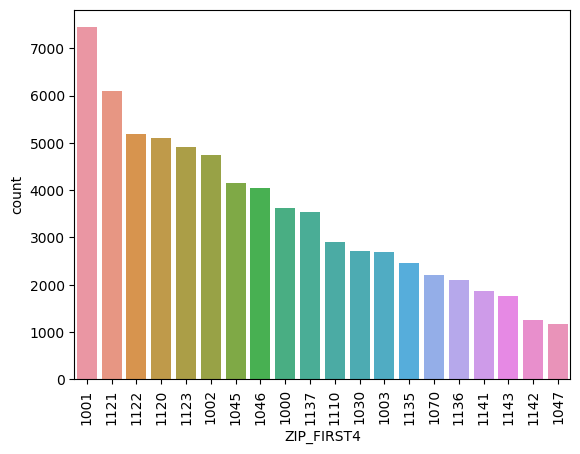

In [319]:
sns.countplot(x='ZIP_FIRST4',data=normal_cus,
              order=normal_cus['ZIP_FIRST4'].value_counts()[:20].index)
a = plt.xticks(rotation = 90)
ax = plt.gca()

<Figure size 500x400 with 0 Axes>

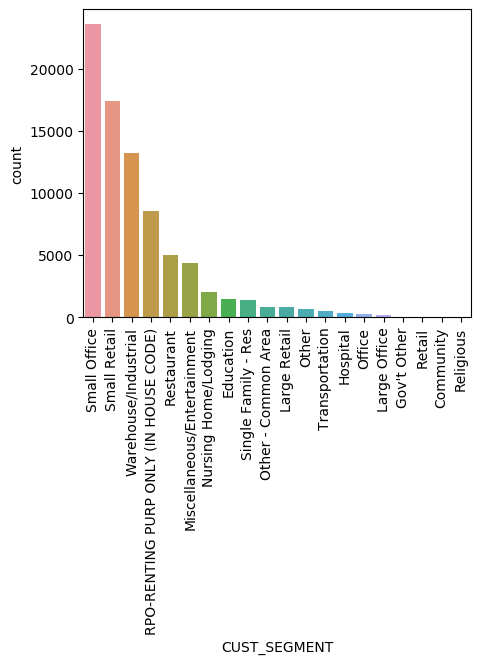

In [321]:
plt.figure(figsize=(5,4))
sns.countplot(x='CUST_SEGMENT',data=normal_cus,
              order=normal_cus['CUST_SEGMENT'].value_counts()[:20].index)
a = plt.xticks(rotation = 90)
ax = plt.gca()


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


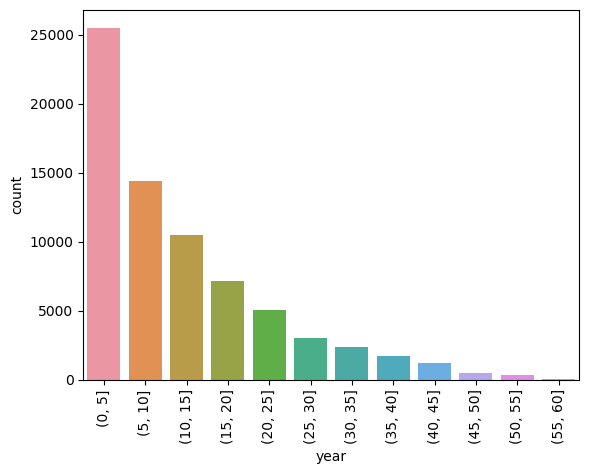

In [322]:
normal_cus = normal_cus[normal_cus['day_since'] != 80615]
normal_cus['year'] = normal_cus['day_since']/365
normal_cus['year'] = normal_cus['year'].astype('int')
bins = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
# pd.cut(normal_cus['year'], bins=bins).value_counts()

binsplot = pd.cut(normal_cus['year'], bins=bins)
sns.countplot(binsplot,
              order=binsplot.value_counts()[:12].index)
a=plt.xticks(rotation = 90)

### Anomaly group

In [ ]:
suspicious1 = df_test2[df_test2['y_by_average_cluster']==1]
customer = df_11_11_processed_new.iloc[suspicious1.index] 
customer.info()

In [ ]:
customer['ZIP_FIRST4'].value_counts()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 20 Text xticklabel objects>)

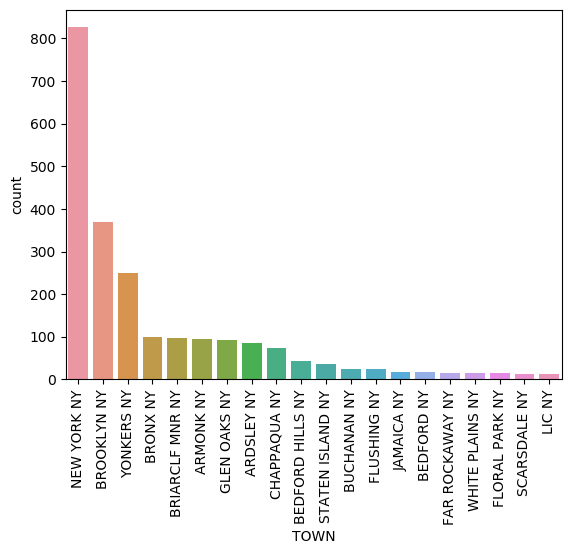

In [201]:
sns.countplot(x='TOWN',data=customer,
              order=customer['TOWN'].value_counts()[:20].index)
plt.xticks(rotation = 90)
ax = plt.gca()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 20 Text xticklabel objects>)

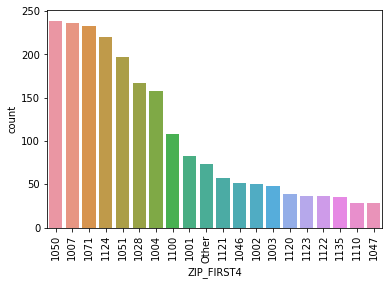

In [106]:
sns.countplot(x='ZIP_FIRST4',data=customer,
              order=customer['ZIP_FIRST4'].value_counts()[:20].index)
plt.xticks(rotation = 90)
ax = plt.gca()

<Figure size 500x400 with 0 Axes>

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 20 Text xticklabel objects>)

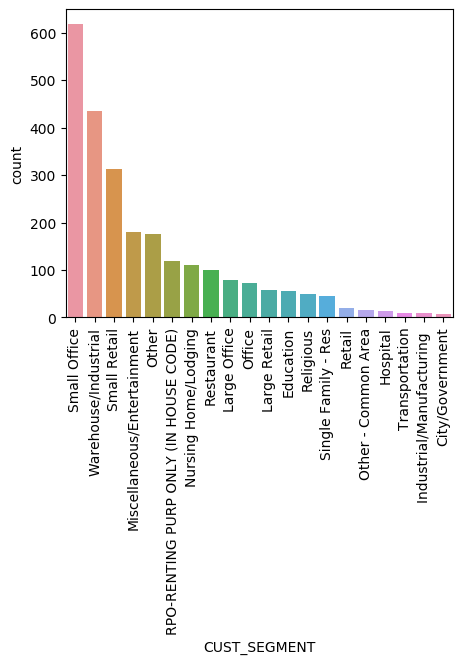

In [258]:
plt.figure(figsize=(5,4))
sns.countplot(x='CUST_SEGMENT',data=customer,
              order=customer['CUST_SEGMENT'].value_counts()[:20].index)

plt.xticks(rotation = 90)
ax = plt.gca()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 20 Text xticklabel objects>)

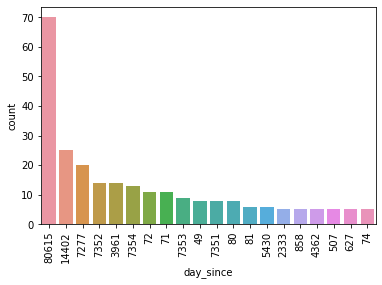

In [110]:
sns.countplot(x='day_since',data=customer,
              order=customer['day_since'].value_counts()[:20].index)
plt.xticks(rotation = 90)
ax = plt.gca()

In [185]:
customer = customer[customer['day_since'] != 80615]
customer['year'] = customer['day_since']/365
customer['year'] = customer['year'].astype('int')
bins = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]
pd.cut(customer['year'], bins=bins).value_counts()

binsplot = pd.cut(customer['year'], bins=bins)
sns.countplot(binsplot,
              order=binsplot.value_counts()[:12].index)
a=plt.xticks(rotation = 90)

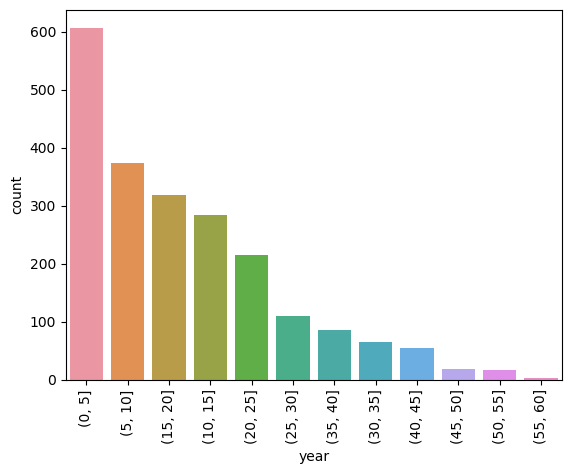

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), <a list of 10 Text xticklabel objects>)

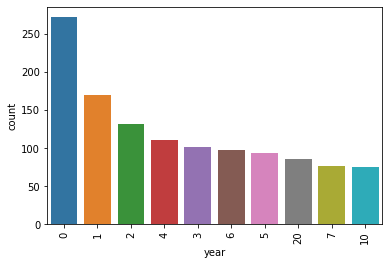

In [198]:
sns.countplot(x='year',data=customer,
              order=customer['year'].value_counts()[:10].index)
plt.xticks(rotation = 90)
ax = plt.gca()

## Model Interpretation

In [18]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
     df2.drop('PROGRAM_PART',axis = 1), df2[target], test_size=0.70, random_state=0) 

In [19]:
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(max_depth=10, n_estimators = 500,random_state=0)
model.fit(X_train, y_train) 

RandomForestRegressor(max_depth=10, n_estimators=500, random_state=0)

In [20]:
len(X_train)

83375

In [21]:
import shap
shap_values = shap.TreeExplainer(model).shap_values(X_train[0:2501])

### Modeling using H2O

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 277919 entries, 0 to 277918
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   ELAC                     277919 non-null  category
 1   ELSC                     277919 non-null  category
 2   ZIP_FIRST4               277919 non-null  category
 3   HI_DMD_1YR               277919 non-null  float64 
 4   AVGOFBILLED_DMD          277919 non-null  int64   
 5   E_PRO_PER                277919 non-null  int64   
 6   day_since                277919 non-null  int64   
 7   AVG_2016_BILL_MULTIPLES  277915 non-null  float64 
 8   AVG_2017_BILL_MULTIPLES  277916 non-null  float64 
 9   AVG_2018_BILL_MULTIPLES  277916 non-null  float64 
 10  AVG_2019_BILL_MULTIPLES  277916 non-null  float64 
 11  AVG_2020_BILL_MULTIPLES  277919 non-null  float64 
 12  PROGRAM_PART             277919 non-null  int64   
dtypes: category(3), float64(6), int64(4)
memory 

In [37]:
import h2o
h2o.init()
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.estimators.random_forest import H2ORandomForestEstimator

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,2 days 3 hours 37 mins
H2O_cluster_timezone:,America/New_York
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.30.1.3
H2O_cluster_version_age:,2 months and 2 days
H2O_cluster_name:,H2O_from_python_yiqiongliu_s0sma4
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.271 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [39]:
train,test = train_test_split(
     df, test_size=0.40, random_state=0, 
        stratify=df['PROGRAM_PART']) 

In [40]:
train_hex = h2o.H2OFrame(train)
test_hex = h2o.H2OFrame(test)

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


In [43]:
import time
import resource 

time_start = time.perf_counter()

gbm_v1 = H2OGradientBoostingEstimator(
        model_id = 'gbm_v1',learn_rate = 0.06, ntrees = 100,
        seed=1234,keep_cross_validation_predictions=True
        ,max_depth=10,min_rows=2,nfolds=10)

gbm_v1.train(predictors,target,training_frame=train_hex)

time_elapsed = (time.perf_counter() - time_start)

memMb=resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0/1024.0
print ("%5.1f secs %5.1f MByte" % (time_elapsed,memMb))

gbm Model Build progress: |███████████████████████████████████████████████| 100%
114.4 secs 519.4 MByte


In [22]:
y_pred = gbm_v1.predict(test_hex).as_data_frame()
y_pred.head()

gbm prediction progress: |████████████████████████████████████████████████| 100%


,predict
0,0.21
1,0.07
2,0.00
3,-0.00
4,0.00


## Model Interpretation

In [ ]:
import shap

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
     df2.drop('PROGRAM_PART',axis = 1), df2[target], test_size=0.70, random_state=0) 

from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(max_depth=10, n_estimators = 500,random_state=0)
model.fit(X_train, y_train) 

len(X_train)

import shap
shap_values = shap.TreeExplainer(model).shap_values(X_train[0:2501])

shap.summary_plot(shap_values, X_train[0:2501])



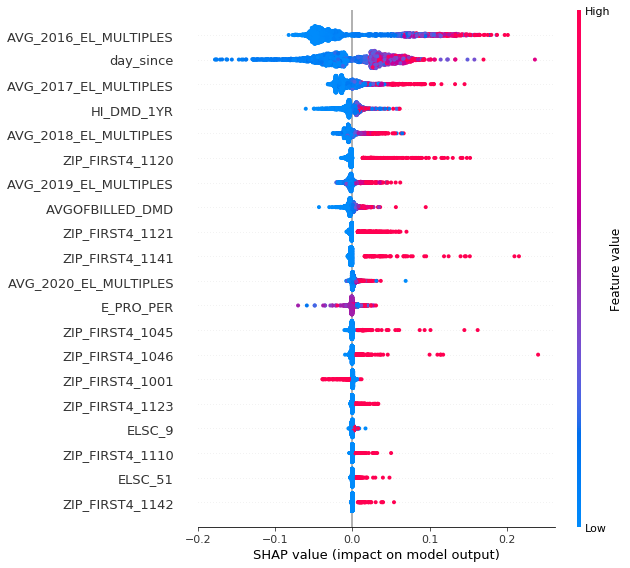

In [22]:
shap.summary_plot(shap_values, X_train[0:2501])

In [14]:
test1 = test_hex.drop(target).as_data_frame()

In [15]:
class H2OProbWrapper:
    def __init__(self, h2o_model, feature_names):
        self.h2o_model = h2o_model
        self.feature_names = feature_names

    def predict_binary_prob(self, X):
        if isinstance(X, pd.Series):
            X = X.values.reshape(1,-1)
        self.dataframe= pd.DataFrame(X, columns=self.feature_names)
        self.predictions = self.h2o_model.predict(h2o.H2OFrame(self.dataframe)).as_data_frame().values
        return self.predictions.astype('float64')[:,-1] #probability of True class

In [16]:
h2o_wrapper = H2OProbWrapper(gbm_v1,predictors)

In [ ]:
h2o_gbm_explainer = shap.KernelExplainer(h2o_wrapper.predict_binary_prob, test1)

In [115]:
gains_table(gbm_v1,test,test_hex)

gbm prediction progress: |████████████████████████████████████████████████| 100%


,count,actual,non_actual,cum_count,cum_actual,cum_non_actual,percent_cum_actual,percent_cum_non_actual,if_random,lift,K_S,gain
decile,,,,,,,,,,,,
0,11117,1624,9493,11117,1624,9493,0.15,0.09,1089.00,1.49,6.00,14.61
1,11117,1565,9552,22234,3189,19045,0.29,0.19,2178.00,1.46,10.00,14.34
2,11117,1632,9485,33351,4821,28530,0.44,0.28,3267.00,1.48,16.00,14.46
3,11117,1677,9440,44468,6498,37970,0.60,0.38,4356.00,1.49,22.00,14.61
4,11116,729,10387,55584,7227,48357,0.66,0.48,5445.00,1.33,18.00,13.00
5,11117,718,10399,66701,7945,58756,0.73,0.59,6534.00,1.22,14.00,11.91
6,11117,690,10427,77818,8635,69183,0.79,0.69,7623.00,1.13,10.00,11.10
7,11117,762,10355,88935,9397,79538,0.86,0.79,8712.00,1.08,7.00,10.57
8,11117,724,10393,100052,10121,89931,0.93,0.90,9801.00,1.03,3.00,10.12


gbm prediction progress: |████████████████████████████████████████████████| 100%


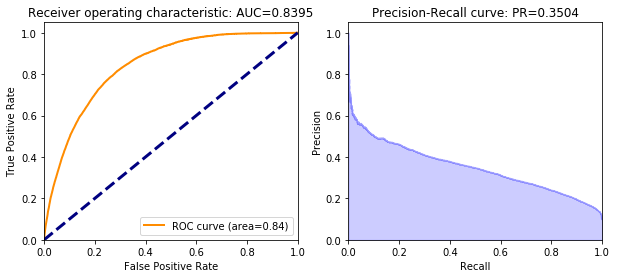

In [46]:
ROC_AUC(gbm_v1,test_hex,target)

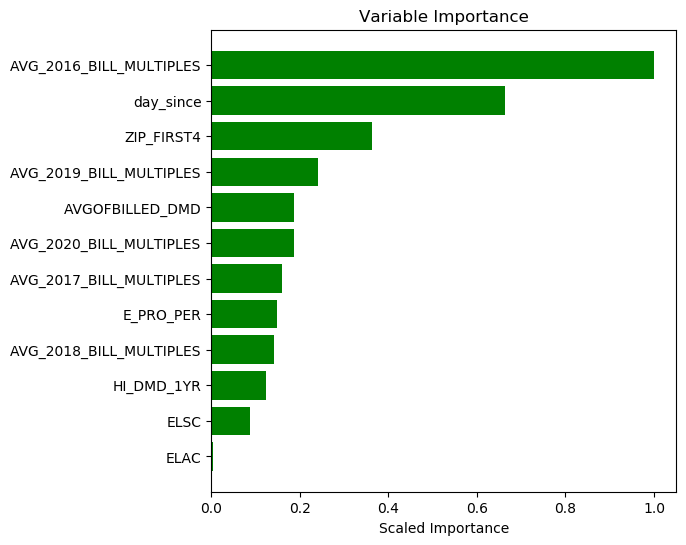

In [199]:
VarImp(gbm_v1)

In [30]:
y_actual = test_hex[target].as_data_frame()
y_pred = gbm_v1.predict(test_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.2, 1, 0)

gbm prediction progress: |████████████████████████████████████████████████| 100%


In [31]:
from sklearn.metrics import f1_score
f1_score(y_actual, y_pred['predict'])

0.4125294712024251

In [32]:
from sklearn.metrics import confusion_matrix, classification_report

print(confusion_matrix(y_actual, y_pred['predict']))
print(classification_report(y_pred['predict'],y_actual))

[[87602 12676]
 [ 4766  6124]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     92368
           1       0.56      0.33      0.41     18800

    accuracy                           0.84    111168
   macro avg       0.72      0.64      0.66    111168
weighted avg       0.82      0.84      0.83    111168



In [233]:
y_actual = test_hex[['MASKED_ID',target]].as_data_frame()
y_actual.columns = ['MASKED_ID','actual']

y_pred = gbm_v1.predict(test_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.25, 1, 0)

join = pd.concat([y_actual,y_pred['predict']],axis = 1)

result = test.merge(join,on='MASKED_ID',how='inner')


In [234]:
y_actual.head()

,MASKED_ID,PROGRAM_PART
0,100002284347,0
1,100001204928,0
2,100003991689,0
3,100006947344,0
4,100007057199,0


In [236]:
join.head()

,MASKED_ID,actual,predict
0,100002284347,0,0
1,100001204928,0,0
2,100003991689,0,0
3,100006947344,0,0
4,100007057199,0,0


In [238]:
df_11_11_processed_new['Boro'].value_counts()

BK    72814
MN    67849
QN    56512
WS    36420
BX    31247
SI    13077
Name: Boro, dtype: int64

In [237]:
len(result)

111168

In [283]:
gbm_v2.predict(test_hex).as_data_frame()

gbm prediction progress: |████████████████████████████████████████████████| 100%


,predict,p0,p1
0,1,0.76,0.24
1,0,0.94,0.06
2,0,0.99,0.01
3,0,1.00,0.00
4,0,1.00,0.00
5,0,1.00,0.00
6,0,0.90,0.10
7,1,0.73,0.27
8,0,0.98,0.02
9,0,1.00,0.00


gbm Model Build progress: |███████████████████████████████████████████████| 100%
gbm prediction progress: |████████████████████████████████████████████████| 100%


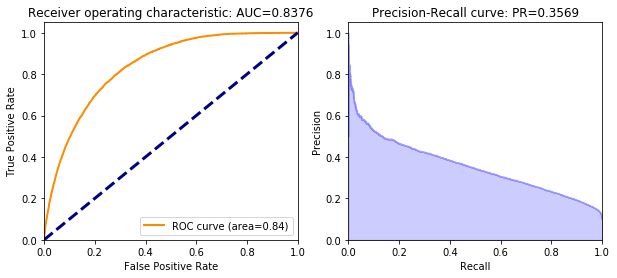

gbm prediction progress: |████████████████████████████████████████████████| 100%
[[87487 12791]
 [ 4808  6082]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     92295
           1       0.56      0.32      0.41     18873

    accuracy                           0.84    111168
   macro avg       0.72      0.64      0.66    111168
weighted avg       0.82      0.84      0.82    111168



In [117]:
gbm_v2 = H2OGradientBoostingEstimator(
        model_id = 'gbm_v2',learn_rate = 0.07, ntrees = 100,
        seed=1234)

gbm_v2.train(predictors,target,training_frame=train_hex)
ROC_AUC(gbm_v2,test_hex,target)
y_actual = test_hex[target].as_data_frame()
y_pred = gbm_v2.predict(test_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.2, 1, 0)
print(confusion_matrix(y_actual, y_pred['predict']))
print(classification_report(y_pred['predict'],y_actual))

In [118]:
gains_table(gbm_v2,test,test_hex)

gbm prediction progress: |████████████████████████████████████████████████| 100%


,count,actual,non_actual,cum_count,cum_actual,cum_non_actual,percent_cum_actual,percent_cum_non_actual,if_random,lift,K_S,gain
decile,,,,,,,,,,,,
0,11117,1629,9488,11117,1629,9488,0.15,0.09,1089.00,1.50,6.00,14.65
1,11117,1598,9519,22234,3227,19007,0.30,0.19,2178.00,1.48,11.00,14.51
2,11117,1594,9523,33351,4821,28530,0.44,0.28,3267.00,1.48,16.00,14.46
3,11117,1675,9442,44468,6496,37972,0.60,0.38,4356.00,1.49,22.00,14.61
4,11116,731,10385,55584,7227,48357,0.66,0.48,5445.00,1.33,18.00,13.00
5,11117,718,10399,66701,7945,58756,0.73,0.59,6534.00,1.22,14.00,11.91
6,11117,690,10427,77818,8635,69183,0.79,0.69,7623.00,1.13,10.00,11.10
7,11117,762,10355,88935,9397,79538,0.86,0.79,8712.00,1.08,7.00,10.57
8,11117,724,10393,100052,10121,89931,0.93,0.90,9801.00,1.03,3.00,10.12


### Random Forest

drf Model Build progress: |███████████████████████████████████████████████| 100%
401.2 secs 3430.1 MByte
drf prediction progress: |████████████████████████████████████████████████| 100%


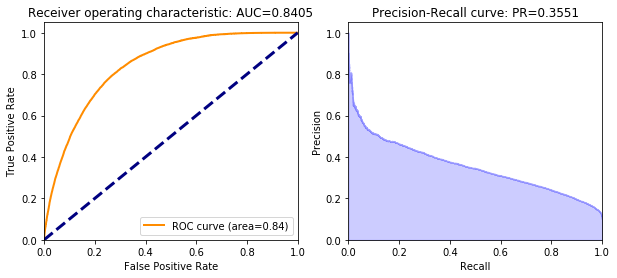

drf prediction progress: |████████████████████████████████████████████████| 100%
[[87418 12860]
 [ 4786  6104]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     92204
           1       0.56      0.32      0.41     18964

    accuracy                           0.84    111168
   macro avg       0.72      0.63      0.66    111168
weighted avg       0.82      0.84      0.82    111168



In [119]:
time_start1 = time.perf_counter()

rf = H2ORandomForestEstimator(
        model_id = 'rf',
        ntrees = 500,
        nfolds=5,
        min_rows=50,
        seed=1234, keep_cross_validation_predictions=True)

rf.train(predictors,target,training_frame=train_hex)

time_elapsed1 = (time.perf_counter() - time_start1)
memMb1=resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0/1024.0
print ("%5.1f secs %5.1f MByte" % (time_elapsed1,memMb1))

ROC_AUC(rf,test_hex,target)
y_actual = test_hex[target].as_data_frame()
y_pred = rf.predict(test_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.2, 1, 0)
print(confusion_matrix(y_actual, y_pred['predict']))
print(classification_report(y_pred['predict'],y_actual))

In [120]:
gains_table(rf,test,test_hex)

drf prediction progress: |████████████████████████████████████████████████| 100%


,count,actual,non_actual,cum_count,cum_actual,cum_non_actual,percent_cum_actual,percent_cum_non_actual,if_random,lift,K_S,gain
decile,,,,,,,,,,,,
0,11117,1640,9477,11117,1640,9477,0.15,0.09,1089.00,1.51,6.00,14.75
1,11117,1561,9556,22234,3201,19033,0.29,0.19,2178.00,1.47,10.00,14.40
2,11117,1621,9496,33351,4822,28529,0.44,0.28,3267.00,1.48,16.00,14.46
3,11117,1674,9443,44468,6496,37972,0.60,0.38,4356.00,1.49,22.00,14.61
4,11116,731,10385,55584,7227,48357,0.66,0.48,5445.00,1.33,18.00,13.00
5,11117,718,10399,66701,7945,58756,0.73,0.59,6534.00,1.22,14.00,11.91
6,11117,690,10427,77818,8635,69183,0.79,0.69,7623.00,1.13,10.00,11.10
7,11117,762,10355,88935,9397,79538,0.86,0.79,8712.00,1.08,7.00,10.57
8,11117,724,10393,100052,10121,89931,0.93,0.90,9801.00,1.03,3.00,10.12


In [480]:
test_hex.head()

Unnamed: 0.1,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since
133253,1.00002e+11,ACTIVE,9,NEW YORK NY,10019,4.07642e+07,7.39829e+07,2010-04-24 00:00:00,55.6,MN,98849,43,427,0,Restaurant,0,0,2661.48,2403.67,2210.65,2572.93,1578.71,0,0,26280,24286.7,23976.7,23423.3,7195,3801
31446,1.00001e+11,ACTIVE,2,BROOKLYN NY,11236,4.06401e+07,7.39135e+07,2011-04-30 00:00:00,0,BK,2620,0,365,0,RPO-RENTING PURP ONLY (IN HOUSE CODE),0,0,109.72,91.8425,100.895,77.03,86.4925,0,0,384,263,291.167,199.667,228.75,3430
211552,1.00004e+11,ACTIVE,2,NEW ROCHELLE NY,10801,4.09254e+07,7.37897e+07,2016-11-28 00:00:00,0,WS,1087,0,397,0,Warehouse/Industrial,0,0,54.06,40.2925,40.7875,40.0483,45.3088,0,0,99,79.25,93.6667,85,86.25,1391
324378,1.00007e+11,ACTIVE,2,JACKSON HGTS NY,11372,4.07491e+07,7.38699e+07,2019-12-12 00:00:00,0,QN,4337,0,424,0,Small Retail,0,0,0,0,0,76.83,195.928,0,0,0,0,0,206,604,282
334981,1.00007e+11,ACTIVE,2,NEW YORK NY,10027,4.08071e+07,7.39439e+07,2020-07-24 00:00:00,0,MN,476,0,46,0,Small Office,0,0,0,0,0,0,64.72,0,0,0,0,0,0,60,57
356916,1.00007e+11,ACTIVE,2,BROOKLYN NY,11220,4.06391e+07,7.40129e+07,2020-07-28 00:00:00,1.08,BK,1967,1,49,0,Small Office,0,0,0,0,0,0,60.52,0,0,0,0,0,0,132,53
79613,1.00001e+11,ACTIVE,2,BRONX NY,10451,4.08133e+07,7.39286e+07,2009-06-10 00:00:00,0,BX,2287,0,365,0,Warehouse/Industrial,0,0,183.57,144.664,159.113,182.393,42.735,0,0,738,489,531,639.25,43.125,4119
87027,1.00002e+11,ACTIVE,9,BRONX NY,10460,4.08367e+07,7.38858e+07,2003-12-30 00:00:00,16.4,BX,80429,14,395,0,Small Retail,0,0,918.69,705.675,676.317,995.932,711.095,0,0,9420,6741.82,6923.33,9872.73,6830,6108
231623,1.00005e+11,ACTIVE,2,SUNNYSIDE NY,11104,4.07419e+07,7.39197e+07,2017-06-02 00:00:00,9.18,QN,28229,5,397,0,Small Retail,0,0,0,334.065,457.872,629.368,477.735,0,0,0,1273.75,1859.75,2683.75,1918.25,1205
277356,1.00006e+11,ACTIVE,2,LIC NY,11101,4.07494e+07,7.39463e+07,2019-01-07 00:00:00,0.84,QN,82,0,426,0,Small Office,0,0,0,0,0,91.39,33.9817,0,0,0,0,0,33.6,4,621


In [481]:
train_hex.head()

Unnamed: 0.1,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since
275436,1.00006e+11,ACTIVE,9,MOUNT VERNON NY,10553,4.09095e+07,7.38238e+07,2018-12-01 00:00:00,18.18,WS,34609,16,396,0,Warehouse/Industrial,0,0,0,0,880.83,909.7,728.163,0,0,0,0,2916,3397.85,2592,658
119839,1.00002e+11,ACTIVE,9,NEW YORK NY,10035,4.0806e+07,7.39413e+07,2015-01-29 00:00:00,13.14,MN,26636,7,756,0,Other - Common Area,0,0,423.755,556.253,228.178,1027.52,801.553,0,0,1441,2047.42,825.636,4106.57,3975.75,2060
115882,1.00002e+11,ACTIVE,2,NEW YORK NY,10010,4.07393e+07,7.39828e+07,2008-08-01 00:00:00,2.4,MN,1872,2,365,0,Education,0,0,85.04,95.6225,88.9767,87.7692,67.5238,0,0,303,315,287.833,279,171,4432
349409,1.00007e+11,ACTIVE,2,JAMAICA NY,11435,4.06992e+07,7.38065e+07,2020-06-27 00:00:00,0,QN,3185,0,51,0,Small Office,0,0,0,0,0,0,80.1767,0,0,0,0,0,0,199.333,84
275525,1.00006e+11,HOLD,2,FLUSHING NY,11358,4.07619e+07,7.38023e+07,2020-04-01 00:00:00,2.88,QN,1251,1,119,0,Other,0,0,0,0,0,0,113.55,0,0,0,0,0,0,204,171
185180,1.00003e+11,ACTIVE,9,LIC NY,11101,4.07519e+07,7.39444e+07,2009-02-24 00:00:00,17.28,QN,63233,13,364,0,Small Retail,0,0,1513.82,986.31,1047.21,979.329,1107.76,0,0,8244,5019,5737,5228,5921.14,4225
132556,1.00002e+11,ACTIVE,2,NEW YORK NY,10003,4.0733e+07,7.39907e+07,1987-10-13 00:00:00,3.12,MN,2880,2,365,0,Small Retail,0,0,53.1,66.8125,73.4642,78.8909,80.3257,0,0,210,299.667,324.417,341.364,276,12030
12809,1.00001e+11,ACTIVE,2,BROOKLYN NY,11211,4.0713e+07,7.39574e+07,2011-09-07 00:00:00,9.18,BK,25578,8,393,0,Other - Common Area,0,0,154.43,175.207,425.23,422.511,641.497,0,0,558,621.818,1704,1750.5,2544.75,3300
39191,1.00001e+11,ACTIVE,2,BROOKLYN NY,11209,4.06284e+07,7.40282e+07,1973-01-05 00:00:00,3.24,BK,7356,3,365,0,Restaurant,0,0,211.99,223.71,233.749,195.838,190.536,0,0,911,815.917,852.667,713.917,648,17424
247709,1.00006e+11,ACTIVE,2,BROOKLYN NY,11221,4.06954e+07,7.39304e+07,2018-09-12 00:00:00,0,BK,418,0,365,0,Warehouse/Industrial,0,0,0,0,33.898,43.66,40.8814,0,0,0,0,27.6,56.1667,34.7143,738


### XGBoosting

xgboost Model Build progress: |███████████████████████████████████████████| 100%
 78.8 secs 519.4 MByte
xgboost prediction progress: |████████████████████████████████████████████| 100%


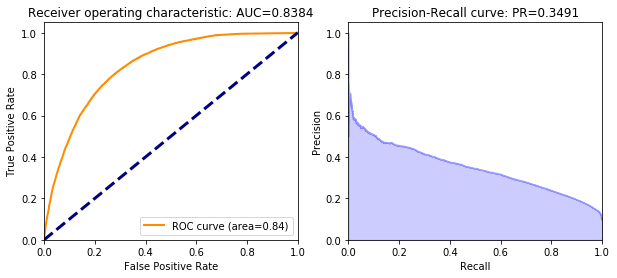

xgboost prediction progress: |████████████████████████████████████████████| 100%
[[87394 12884]
 [ 4697  6193]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     92091
           1       0.57      0.32      0.41     19077

    accuracy                           0.84    111168
   macro avg       0.72      0.64      0.66    111168
weighted avg       0.82      0.84      0.82    111168



In [47]:
from h2o.estimators import H2OXGBoostEstimator

time_start2 = time.perf_counter()

xgb = H2OXGBoostEstimator(booster='dart',normalize_type="tree",
                          seed=1234,nfolds=5,
                          keep_cross_validation_predictions=True)

xgb.train(x=predictors,
                  y=target,
                  training_frame=train_hex)

time_elapsed2 = (time.perf_counter() - time_start2)
memMb2=resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0/1024.0
print ("%5.1f secs %5.1f MByte" % (time_elapsed2,memMb2))

ROC_AUC(xgb,test_hex,target)
y_actual = test_hex[target].as_data_frame()
y_pred = xgb.predict(test_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.2, 1, 0)
print(confusion_matrix(y_actual, y_pred['predict']))
print(classification_report(y_pred['predict'],y_actual))

In [ ]:
VarImp(xgb)

In [49]:
df_11_11_processed_new['2016_AVG_EL_CONSUMP'].value_counts()

0.00           85969
360.00           631
180.00           604
720.00           581
18.00            555
540.00           554
36.00            499
432.00           483
90.00            478
1080.00          476
270.00           473
468.00           466
324.00           464
216.00           453
684.00           453
576.00           451
108.00           450
450.00           450
144.00           448
396.00           447
864.00           440
504.00           436
648.00           432
756.00           431
612.00           428
900.00           426
630.00           426
288.00           422
792.00           419
120.00           415
72.00            411
252.00           410
828.00           405
54.00            400
972.00           400
936.00           398
162.00           398
1440.00          398
240.00           397
810.00           396
306.00           396
414.00           392
126.00           379
522.00           379
702.00           376
1116.00          375
666.00           367
342.00       

In [310]:
len(df_11_11_processed_new)

277919

### AUTO ML

In [455]:
from h2o.automl import H2OAutoML
aml_v1 = H2OAutoML(max_runtime_secs = 60, max_models=20, seed=1)
aml_v1.train(predictors,target,training_frame=train_hex)

AutoML progress: |████████████████████████████████████████████████████████| 100%


In [460]:
aml_v1.leaderboard.head()
preds = aml_v1.predict(test_hex)
pred = aml_v1.leader.predict(test_hex)
perf = aml_v1.leader.model_performance(test_hex)
perf

model_id,mean_residual_deviance,rmse,mse,mae,rmsle
StackedEnsemble_AllModels_AutoML_20201119_204513,0.073497,0.271103,0.073497,0.148921,0.190012
StackedEnsemble_BestOfFamily_AutoML_20201119_204513,0.0736653,0.271414,0.0736653,0.149281,0.190219
XGBoost_grid__1_AutoML_20201119_204513_model_1,0.0741512,0.272307,0.0741512,0.154152,0.19106
DeepLearning_1_AutoML_20201119_204513,0.0778213,0.278965,0.0778213,0.151537,nan
GBM_grid__1_AutoML_20201119_204513_model_1,0.0817619,0.28594,0.0817619,0.168687,0.198169
GBM_3_AutoML_20201119_204513,0.0832202,0.288479,0.0832202,0.170908,0.200055
GBM_2_AutoML_20201119_204513,0.083338,0.288683,0.083338,0.171072,0.200243
GBM_1_AutoML_20201119_204513,0.0833914,0.288776,0.0833914,0.171115,0.200316
DeepLearning_grid__1_AutoML_20201119_204513_model_1,0.0838769,0.289615,0.0838769,0.13739,nan
GBM_4_AutoML_20201119_204513,0.0844462,0.290596,0.0844462,0.172435,0.201828


stackedensemble prediction progress: |████████████████████████████████████| 100%


/Users/yiqiongliu/opt/anaconda3/lib/python3.7/site-packages/h2o/job.py:70: UserWarning: Test/Validation dataset column 'TOWN' has levels not trained on: [QUEENS NY]
  warnings.warn(w)


stackedensemble prediction progress: |████████████████████████████████████| 100%

ModelMetricsRegressionGLM: stackedensemble
** Reported on test data. **

MSE: 0.07350129045444974
RMSE: 0.27111121418054573
MAE: 0.14976066502911
RMSLE: 0.1893616810891445
R^2: 0.16819599793704232
Mean Residual Deviance: 0.07350129045444974
Null degrees of freedom: 111167
Residual degrees of freedom: 111155
Null deviance: 9823.217296000224
Residual deviance: 8170.991457240269
AIC: 25310.354685291913


### Stacking model

In [407]:
h2o.shutdown(prompt = True)


/Users/yiqiongliu/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Deprecated, use ``h2o.cluster().shutdown()``.
  """Entry point for launching an IPython kernel.


Are you sure you want to shutdown the H2O instance running at http://localhost:54321 (Y/N)? y
H2O session _sid_858b closed.


In [485]:
import h2o
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,2 days 19 hours 20 mins
H2O_cluster_timezone:,America/New_York
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.30.1.3
H2O_cluster_version_age:,1 month and 24 days
H2O_cluster_name:,H2O_from_python_yiqiongliu_0zu0e4
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,821 Mb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [486]:
df_11_11_processed = pd.read_csv('df_11_11_processed.csv')
df_11_11_processed['MASKED_ID']=df_11_11_processed['MASKED_ID'].astype('object')
df_11_11_processed['ELSC']=df_11_11_processed['ELSC'].astype('object')
df_11_11_processed['PROGRAM_PART'] = np.where(df_11_11_processed['PROGRAM_PART'] == 'Y', 1, 0)
df_11_11_processed.drop(['Unnamed: 0'],inplace=True,axis=1)

df_11_11_processed2 = df_11_11_processed.copy()
df_11_11_processed2.drop('Unnamed: 0.1',axis=1, inplace=True)
df_11_11_processed2.loc[df_11_11_processed2['ELSC'].
                           isin((df_11_11_processed2['ELSC'].value_counts()[df_11_11_processed2['ELSC'].value_counts() < 300]).index), 'ELSC'] = 'Other'

df_11_11_processed2['ELSC']=df_11_11_processed2['ELSC'].astype('category')
df_11_11_processed2['TURN_ON_DT'] = pd.to_datetime(df_11_11_processed2['TURN_ON_DT'])
df_11_11_processed2['day_since'] = (df_11_11_processed2['TURN_ON_DT'].max()-
                                       df_11_11_processed2['TURN_ON_DT']).dt.days

In [226]:
predictors = ['ELAC', 'ELSC', 'TOWN', 'HI_DMD_1YR', 'Boro', 'AVGOFBILLED_DMD',
       'E_PRO_PER', '2016_AVG_BILL_CONSUMP', 'day_since',
       '2017_AVG_BILL_CONSUMP', '2018_AVG_BILL_CONSUMP',
       '2019_AVG_BILL_CONSUMP', '2020_AVG_BILL_CONSUMP','2016_AVG_EL_CONSUMP', '2017_AVG_EL_CONSUMP',
       '2018_AVG_EL_CONSUMP', '2019_AVG_EL_CONSUMP', '2020_AVG_EL_CONSUMP']

predictors2 = ['ELAC', 'ELSC', 'HI_DMD_1YR', 'AVGOFBILLED_DMD', 'ZIP_FIRST4',
       'E_PRO_PER', 'day_since','AVG_2016_BILL_MULTIPLES',
        'AVG_2017_BILL_MULTIPLES',
       'AVG_2018_BILL_MULTIPLES', 'AVG_2019_BILL_MULTIPLES',
       'AVG_2020_BILL_MULTIPLES']

target = 'PROGRAM_PART'

In [218]:
new1204 = df_11_11_processed_new[['ELAC', 'ELSC', 'HI_DMD_1YR', 'AVGOFBILLED_DMD', 'ZIP_FIRST4',
       'E_PRO_PER', 'day_since','AVG_2016_BILL_MULTIPLES',
        'AVG_2017_BILL_MULTIPLES',
       'AVG_2018_BILL_MULTIPLES', 'AVG_2019_BILL_MULTIPLES',
       'AVG_2020_BILL_MULTIPLES', 'PROGRAM_PART']]

In [219]:
new1204.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 277919 entries, 0 to 277918
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   ELAC                     277919 non-null  category
 1   ELSC                     277919 non-null  category
 2   HI_DMD_1YR               277919 non-null  float64 
 3   AVGOFBILLED_DMD          277919 non-null  int64   
 4   ZIP_FIRST4               277919 non-null  category
 5   E_PRO_PER                277919 non-null  int64   
 6   day_since                277919 non-null  int64   
 7   AVG_2016_BILL_MULTIPLES  277919 non-null  float64 
 8   AVG_2017_BILL_MULTIPLES  277919 non-null  float64 
 9   AVG_2018_BILL_MULTIPLES  277919 non-null  float64 
 10  AVG_2019_BILL_MULTIPLES  277919 non-null  float64 
 11  AVG_2020_BILL_MULTIPLES  277919 non-null  float64 
 12  PROGRAM_PART             277919 non-null  int64   
dtypes: category(3), float64(6), int64(4)
memory 

In [220]:
train2,test2 = train_test_split(
     new1204, test_size=0.40, random_state=0, 
        stratify=new1204['PROGRAM_PART'])  

In [221]:
train_hex2 = h2o.H2OFrame(train2)
test_hex2 = h2o.H2OFrame(test2)

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


In [397]:
train2.head()

,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since
235518,100006304110,ACTIVE,9,MOUNT VERNON NY,10553,40909463.00,73823848.00,2018-12-01,18.18,WS,34609,16,396,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,880.83,909.70,728.16,0.00,0.00,0.00,0.00,2916.00,3397.85,2592.00,658
111436,100002082358,ACTIVE,9,NEW YORK NY,10035,40805998.00,73941317.00,2015-01-29,13.14,MN,26636,7,756,0,Other - Common Area,0.00,0.00,423.75,556.25,228.18,1027.52,801.55,0.00,0.00,1441.00,2047.42,825.64,4106.57,3975.75,2060
107743,100002018819,ACTIVE,2,NEW YORK NY,10010,40739303.00,73982833.00,2008-08-01,2.40,MN,1872,2,365,0,Education,0.00,0.00,85.04,95.62,88.98,87.77,67.52,0.00,0.00,303.00,315.00,287.83,279.00,171.00,4432
275154,100007225582,ACTIVE,2,JAMAICA NY,11435,40699179.00,73806458.00,2020-06-27,0.00,QN,3185,0,51,0,Small Office,0.00,0.00,0.00,0.00,0.00,0.00,80.18,0.00,0.00,0.00,0.00,0.00,0.00,199.33,84
235566,100006306833,HOLD,2,FLUSHING NY,11358,40761945.00,73802253.00,2020-04-01,2.88,QN,1251,1,119,0,Other,0.00,0.00,0.00,0.00,0.00,0.00,113.55,0.00,0.00,0.00,0.00,0.00,0.00,204.00,171


In [222]:
train_hex2[target] = train_hex2[target].asfactor()
test_hex2[target] = test_hex2[target].asfactor()

In [223]:
from sklearn import ensemble
from sklearn.ensemble import StackingClassifier
from sklearn.ensemble import RandomForestClassifier

In [224]:
from h2o.estimators.random_forest import H2ORandomForestEstimator
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.estimators.stackedensemble import H2OStackedEnsembleEstimator
from h2o.grid.grid_search import H2OGridSearch


In [227]:

xgb_cv = H2OXGBoostEstimator(booster='dart',
                                  normalize_type="tree",
                                  seed=1234,keep_cross_validation_predictions=True,
                         nfolds=5)

xgb_cv.train(x=predictors2, y=target, training_frame=train_hex2)


xgboost Model Build progress: |███████████████████████████████████████████| 100%


In [229]:
rf_cv = H2ORandomForestEstimator(
        model_id = 'rf_v5',
        ntrees = 500,
        nfolds=5,
        min_rows=50,
        seed=1234, keep_cross_validation_predictions=True)
rf_cv.train(x=predictors2, y=target, training_frame=train_hex2)

drf Model Build progress: |███████████████████████████████████████████████| 100%


In [230]:
gbm_cv = H2OGradientBoostingEstimator(
        model_id = 'gbm_v2',learn_rate = 0.06, ntrees = 100,nfolds=5,
        seed=1234, keep_cross_validation_predictions=True)

gbm_cv.train(x=predictors2, y=target, training_frame=train_hex2)

gbm Model Build progress: |███████████████████████████████████████████████| 100%


In [231]:
time_start3 = time.perf_counter()

ensemble2 = H2OStackedEnsembleEstimator(model_id="ensemble",
                                       base_models=[xgb_cv, gbm_cv, rf_cv])
ensemble2.train(x=predictors2, y=target, training_frame=train_hex2)

time_elapsed3 = (time.perf_counter() - time_start3)
memMb3=resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/1024.0/1024.0
print ("%5.1f secs %5.1f MByte" % (time_elapsed3,memMb3))

stackedensemble Model Build progress: |███████████████████████████████████| 100%
  1.4 secs 3657.1 MByte


stackedensemble prediction progress: |████████████████████████████████████| 100%


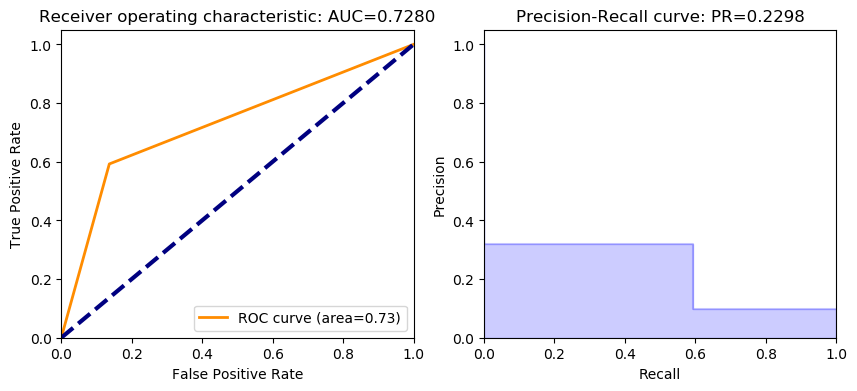

In [237]:
ROC_AUC(ensemble2,test_hex2,target)

In [232]:
perf_stack_test = ensemble2.model_performance(test_hex2)

In [235]:
perf_gbm_test = gbm_cv.model_performance(test_hex2)
perf_xgb_test = xgb_cv.model_performance(test_hex2)
perf_rf_test = rf_cv.model_performance(test_hex2)

In [236]:
baselearner_best_auc_test = max(perf_gbm_test.auc(), perf_rf_test.auc(),perf_xgb_test.auc())
stack_auc_test = perf_stack_test.auc()
print("Best Base-learner Test AUC:  {0}".format(baselearner_best_auc_test))
print("Ensemble Test AUC:  {0}".format(stack_auc_test))


Best Base-learner Test AUC:  0.8444007623911128
Ensemble Test AUC:  0.844404067711047


In [233]:
perf_stack_test


ModelMetricsBinomialGLM: stackedensemble
** Reported on test data. **

MSE: 0.07482044854111473
RMSE: 0.2735332677045239
LogLoss: 0.2563331784568373
Null degrees of freedom: 111167
Residual degrees of freedom: 111164
Null deviance: 71275.81434539548
Residual deviance: 56992.09356537937
AIC: 57000.09356537937
AUC: 0.844404067711047
AUCPR: 0.36293325428280143
Gini: 0.6888081354220941

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.1517257352737895: 


,,0,1,Error,Rate
0,0,87845.00,12433.00,0.124,(12433.0/100278.0)
1,1,4723.00,6167.00,0.4337,(4723.0/10890.0)
2,Total,92568.00,18600.00,0.1543,(17156.0/111168.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.15,0.42,260.00
1,max f2,0.08,0.55,321.00
2,max f0point5,0.28,0.40,191.00
3,max accuracy,0.63,0.90,64.00
4,max precision,0.97,0.88,1.00
5,max recall,0.03,1.00,399.00
6,max specificity,0.98,1.00,0.00
7,max absolute_mcc,0.10,0.35,300.00
8,max min_per_class_accuracy,0.08,0.76,319.00
9,max mean_per_class_accuracy,0.07,0.77,331.00



Gains/Lift Table: Avg response rate:  9.80 %, avg score:  9.85 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.01,0.67,5.88,5.88,0.58,0.77,0.58,0.77,0.06,0.06,488.44,488.44,0.05
1,2,0.02,0.56,4.74,5.31,0.46,0.61,0.52,0.69,0.05,0.11,373.69,431.07,0.10
2,3,0.03,0.49,4.41,5.01,0.43,0.52,0.49,0.63,0.04,0.15,340.64,400.93,0.13
3,4,0.04,0.44,4.34,4.84,0.42,0.46,0.47,0.59,0.04,0.19,333.69,384.13,0.17
4,5,0.05,0.39,3.97,4.67,0.39,0.42,0.46,0.55,0.04,0.23,296.58,366.62,0.20
5,6,0.10,0.24,3.29,3.98,0.32,0.31,0.39,0.43,0.16,0.40,229.32,297.97,0.33
6,7,0.15,0.17,2.58,3.51,0.25,0.20,0.34,0.35,0.13,0.53,157.64,251.19,0.42
7,8,0.20,0.12,2.00,3.13,0.20,0.14,0.31,0.30,0.10,0.63,100.20,213.45,0.47
8,9,0.30,0.08,1.53,2.60,0.15,0.09,0.25,0.23,0.15,0.78,52.71,159.87,0.53
9,10,0.40,0.06,0.91,2.18,0.09,0.06,0.21,0.19,0.09,0.87,-9.36,117.56,0.52


In [267]:
# 2. Generate a random grid of models and stack them together

# Specify GBM hyperparameters for the grid
hyper_params = {"learn_rate": [0.06, 0.03],
                "max_depth": [3, 4, 5, 6, 9],
                "sample_rate": [0.7, 0.8, 0.9, 1.0],
                "col_sample_rate": [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]}
search_criteria = {"strategy": "RandomDiscrete", "max_models": 3, "seed": 1}

# Train the grid
grid = H2OGridSearch(model=H2OGradientBoostingEstimator(ntrees=10,
                                                        seed=1,
                                                        nfolds=5,
                                                        keep_cross_validation_predictions=True),
                     hyper_params=hyper_params,
                     search_criteria=search_criteria,
                     grid_id="gbm_grid_binomial")
grid.train(x=predictors, y=target, training_frame=train_hex)

gbm Grid Build progress: |████████████████████████████████████████████████| 100%


In [269]:
# Train a stacked ensemble using the GBM grid
ensemble = H2OStackedEnsembleEstimator(model_id="my_ensemble_gbm_grid_binomial",
                                       base_models=grid.model_ids)
ensemble.train(x=predictors, y=target, training_frame=train_hex)

# Eval ensemble performance on the test data
perf_stack_test = ensemble.model_performance(test_hex)

# Compare to base learner performance on the test set
baselearner_best_auc_test = max([h2o.get_model(model).model_performance(test_data=test_hex).auc() for model in grid.model_ids])
stack_auc_test = perf_stack_test.auc()
print("Best Base-learner Test AUC:  {0}".format(baselearner_best_auc_test))
print("Ensemble Test AUC:  {0}".format(stack_auc_test))

# Generate predictions on a test set (if neccessary)
pred = ensemble.predict(test_hex)

stackedensemble Model Build progress: |███████████████████████████████████| 100%
Best Base-learner Test AUC:  0.8307294307683226
Ensemble Test AUC:  0.8297447988989141
stackedensemble prediction progress: |████████████████████████████████████| 100%


/Users/yiqiongliu/opt/anaconda3/lib/python3.7/site-packages/h2o/job.py:70: UserWarning: Test/Validation dataset column 'TOWN' has levels not trained on: [QUEENS NY]
  warnings.warn(w)


### Business Interpretation

In [280]:
predictors4 = ['ELAC', 'ELSC', 'ZIP', 'HI_DMD_1YR','AVGOFBILLED_DMD',
              'E_PRO_PER', 'day_since', 'AVG_2016_BILL_MULTIPLES', 'AVG_2017_BILL_MULTIPLES',
              'AVG_2018_BILL_MULTIPLES','AVG_2019_BILL_MULTIPLES','AVG_2020_BILL_MULTIPLES']

target = 'PROGRAM_PART'
df_all = df_11_11_processed_new[['MASKED_ID','ELAC', 'ELSC', 'ZIP', 'HI_DMD_1YR','AVGOFBILLED_DMD',
              'E_PRO_PER', 'day_since', 'AVG_2016_BILL_MULTIPLES', 'AVG_2017_BILL_MULTIPLES',
              'AVG_2018_BILL_MULTIPLES','AVG_2019_BILL_MULTIPLES','AVG_2020_BILL_MULTIPLES',
                           'PROGRAM_PART']]

In [281]:
df_hex = h2o.H2OFrame(df_all) 

Parse progress: |█████████████████████████████████████████████████████████| 100%


In [282]:
gbm_all = H2OGradientBoostingEstimator(
        model_id = 'gbm_v1',learn_rate = 0.06, ntrees = 100,
        seed=1234,keep_cross_validation_predictions=True
        ,max_depth=10,min_rows=2,nfolds=10, balance_classes = True)

gbm_all.train(predictors4,target,training_frame=df_hex)

gbm Model Build progress: |███████████████████████████████████████████████| 100%


In [ ]:
y_actual = df_hex[['MASKED_ID',target]].as_data_frame()
y_actual.columns = ['MASKED_ID','actual']

y_pred = gbm_all.predict(df_hex).as_data_frame()
y_pred['predict'] = np.where(y_pred['predict'] > 0.2, 1, 0)

join = pd.concat([y_actual,y_pred['predict']],axis = 1)

result = df_11_11_processed_new.merge(join, on='MASKED_ID', how='inner')

In [298]:
result.head()

,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since,TOWN_AVG_2016,AVG_2016_BILL_MULTIPLES,TOWN_AVG_2017,AVG_2017_BILL_MULTIPLES,TOWN_AVG_2018,AVG_2018_BILL_MULTIPLES,TOWN_AVG_2019,AVG_2019_BILL_MULTIPLES,TOWN_AVG_2020,AVG_2020_BILL_MULTIPLES,actual,predict
0,100005919400,9,9,NEW YORK NY,10011,40703151.00,74014430.00,2018-04-11,192.00,MN,881149,170,397,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,11282.85,14935.75,11433.74,0.00,0.00,0.00,0.00,66577.78,90945.45,63350.00,892,1045.26,0.00,1217.30,0.00,1222.25,9.23,1321.92,11.30,1314.67,8.70,0,0
1,100005919442,9,9,YONKERS NY,10701,40932053.00,73870683.00,2018-03-16,15.84,WS,61368,12,364,0,Miscellaneous/Entertainment,0.00,0.00,0.00,0.00,435.11,938.57,859.52,0.00,0.00,0.00,0.00,2002.00,5556.00,5078.25,918,473.27,0.00,536.48,0.00,542.57,0.80,596.01,1.57,575.06,1.49,0,0
2,100005919497,2,2,MOUNT VERNON NY,10550,40911425.00,73842656.00,2018-04-30,0.00,WS,7773,0,364,0,Small Office,0.00,0.00,0.00,0.00,151.67,162.77,161.87,0.00,0.00,0.00,0.00,516.62,706.83,697.88,873,338.34,0.00,380.19,0.00,418.31,0.36,431.26,0.38,418.14,0.39,0,0
3,100005919510,2,2,NEW ROCHELLE NY,10801,40913582.00,73789472.00,2019-08-13,1.62,WS,1152,1,365,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,0.00,43.45,50.85,0.00,0.00,0.00,0.00,0.00,57.60,112.50,403,348.85,0.00,421.03,0.00,424.23,0.00,473.54,0.09,480.79,0.11,0,0
4,100005919513,9,9,MOUNT VERNON NY,10550,40899681.00,73821127.00,2018-07-20,20.80,WS,29441,20,364,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,424.27,851.30,817.66,0.00,0.00,0.00,0.00,1493.33,2480.00,2370.00,792,338.34,0.00,380.19,0.00,418.31,1.01,431.26,1.97,418.14,1.96,0,0


In [28]:
# result = pd.concat([test,y_actual,y_pred['predict']],axis = 1)

In [59]:
# result['TURN_ON_DT'] = pd.to_datetime(result['TURN_ON_DT'])

In [60]:
# result['day_since'] = (result['TURN_ON_DT'].max()-result['TURN_ON_DT']).dt.days

In [299]:
all_yes = result[(result['actual'] == 1) & (result['predict'] == 1)]
len(all_yes)

18776

In [ ]:
# all_yes['MASKED_ID'] = all_yes['MASKED_ID'].astype('object')

In [289]:
all_yes.describe()

,ZIP,HI_DMD_1YR,AVGOFBILLED_DMD,E_PRO_PER,day_since,AVG_2016_BILL_MULTIPLES,AVG_2017_BILL_MULTIPLES,AVG_2018_BILL_MULTIPLES,AVG_2019_BILL_MULTIPLES,AVG_2020_BILL_MULTIPLES,PROGRAM_PART,actual,predict
count,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00,18776.00
mean,10919.56,97.34,71.10,388.10,11785.19,4.65,4.56,4.23,3.96,3.90,1.00,1.00,1.00
std,481.32,476.89,358.89,68.12,17843.57,15.39,15.66,14.11,13.00,13.07,0.00,0.00,0.00
min,10001.00,0.00,0.00,42.00,311.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00
25%,10468.00,12.00,9.00,365.00,4428.00,0.78,0.79,0.77,0.73,0.71,1.00,1.00,1.00
50%,11207.00,23.76,18.00,365.00,6848.50,1.62,1.60,1.52,1.44,1.40,1.00,1.00,1.00
75%,11234.00,51.60,39.00,394.00,10663.25,3.45,3.34,3.11,2.92,2.84,1.00,1.00,1.00
max,11693.00,20666.64,18892.00,1586.00,80615.00,741.99,767.01,642.78,600.00,626.76,1.00,1.00,1.00


In [ ]:
# all_yes['ZIP'].value_counts()

In [ ]:
# all_yes['day_since'].value_counts()

In [300]:
all_yes['mark'] = 1 


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [301]:
actual_no_predict_yes = result[(result['actual'] == 0) & 
                                            (result['predict'] == 1)]
# len(actual_no_predict_yes)

In [ ]:
# actual_no_predict_yes['ZIP'].value_counts()

In [ ]:
# actual_no_predict_yes['day_since'].value_counts()

In [302]:
actual_no_predict_yes['mark'] = 2


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [303]:
true_positive_and_missed = pd.concat([actual_no_predict_yes,all_yes],axis=0)

In [304]:
true_positive_and_missed.head()

,MASKED_ID,ELAC,ELSC,TOWN,ZIP,LATITUDE,LONGITUDE,TURN_ON_DT,HI_DMD_1YR,Boro,ANNUALIZED_KWH,AVGOFBILLED_DMD,E_PRO_PER,PROGRAM_PART,CUST_SEGMENT,2014_AVG_BILL_CONSUMP,2015_AVG_BILL_CONSUMP,2016_AVG_BILL_CONSUMP,2017_AVG_BILL_CONSUMP,2018_AVG_BILL_CONSUMP,2019_AVG_BILL_CONSUMP,2020_AVG_BILL_CONSUMP,2014_AVG_EL_CONSUMP,2015_AVG_EL_CONSUMP,2016_AVG_EL_CONSUMP,2017_AVG_EL_CONSUMP,2018_AVG_EL_CONSUMP,2019_AVG_EL_CONSUMP,2020_AVG_EL_CONSUMP,day_since,TOWN_AVG_2016,AVG_2016_BILL_MULTIPLES,TOWN_AVG_2017,AVG_2017_BILL_MULTIPLES,TOWN_AVG_2018,AVG_2018_BILL_MULTIPLES,TOWN_AVG_2019,AVG_2019_BILL_MULTIPLES,TOWN_AVG_2020,AVG_2020_BILL_MULTIPLES,actual,predict,mark
1377,100005959280,9,9,BROOKLYN NY,11249,40709386.00,73968614.00,2018-07-23,360.00,BK,1768222,282,396,0,Warehouse/Industrial,0.00,0.00,0.00,0.00,597.16,17956.08,23724.40,0.00,0.00,0.00,0.00,1280.00,101090.91,157700.00,789,489.65,0.00,529.18,0.00,554.34,1.08,599.83,29.94,596.53,39.77,0,1,2
2868,100000005912,51,51,BROOKLYN NY,11221,40694388.00,73929234.00,1981-03-01,13.14,BK,6317,4,365,0,Miscellaneous/Entertainment,0.00,0.00,92.59,142.70,148.29,135.69,173.25,0.00,0.00,396.00,581.17,578.25,550.50,649.17,14447,489.65,0.19,529.18,0.27,554.34,0.27,599.83,0.23,596.53,0.29,0,1,2
2872,100000006924,51,51,BROOKLYN NY,11216,40679663.00,73953196.00,1978-11-06,18.72,BK,10842,12,546,0,Miscellaneous/Entertainment,0.00,0.00,938.47,308.06,173.89,283.65,225.96,0.00,0.00,3879.00,1222.62,672.55,1135.38,821.25,15293,489.65,1.92,529.18,0.58,554.34,0.31,599.83,0.47,596.53,0.38,0,1,2
2875,100000007157,51,51,BROOKLYN NY,11207,40676859.00,73886756.00,1999-11-23,15.48,BK,17388,8,365,0,Miscellaneous/Entertainment,0.00,0.00,356.42,248.01,228.39,198.25,237.54,0.00,0.00,2772.00,1818.00,1617.00,1375.50,1566.00,7606,489.65,0.73,529.18,0.47,554.34,0.41,599.83,0.33,596.53,0.40,0,1,2
2878,100000008009,51,51,BROOKLYN NY,11233,40673865.00,73909401.00,2010-11-01,24.40,BK,39600,22,365,0,Miscellaneous/Entertainment,0.00,0.00,3030.20,1660.83,1088.34,744.29,845.29,0.00,0.00,15020.00,7506.67,5009.23,3447.27,3702.86,3610,489.65,6.19,529.18,3.14,554.34,1.96,599.83,1.24,596.53,1.42,0,1,2


In [305]:
true_positive_and_missed.to_csv('true_positive_and_missed.csv')

In [295]:
len(true_positive_and_missed)

45778

In [296]:
true_positive_and_missed['mark'].value_counts()

2    27002
1    18776
Name: mark, dtype: int64

In [ ]:
gbm_v1,test_hex,target

In [44]:
def ROC_AUC(my_result,df,target):
    from sklearn.metrics import roc_curve,auc
    from sklearn.metrics import average_precision_score
    from sklearn.metrics import precision_recall_curve
    import matplotlib.pyplot as plt

    # ROC
    y_actual = df[target].as_data_frame()
    y_pred = my_result.predict(df).as_data_frame()['predict']
    fpr = list()
    tpr = list()
    roc_auc = list()
    fpr,tpr,_ = roc_curve(y_actual,y_pred)
    roc_auc = auc(fpr,tpr)
    
    # Precision-Recall
    average_precision = average_precision_score(y_actual,y_pred)
    
    # plotting
    plt.figure(figsize=(10,4))

    # ROC
    plt.subplot(1,2,1)
    plt.plot(fpr,tpr,color='darkorange',lw=2,label='ROC curve (area=%0.2f)' % roc_auc)
    plt.plot([0,1],[0,1],color='navy',lw=3,linestyle='--')
    plt.xlim([0.0,1.0])
    plt.ylim([0.0,1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic: AUC={0:0.4f}'.format(roc_auc))
    plt.legend(loc='lower right')

    # Precision-Recall
    plt.subplot(1,2,2)
    precision,recall,_ = precision_recall_curve(y_actual,y_pred)
    plt.step(recall,precision,color='b',alpha=0.2,where='post')
    plt.fill_between(recall,precision,step='post',alpha=0.2,color='b')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0,1.05])
    plt.xlim([0.0,1.0])
    plt.title('Precision-Recall curve: PR={0:0.4f}'.format(average_precision))
    plt.show()

In [45]:
def VarImp(model_name):
    
    from sklearn.metrics import roc_curve,auc
    from sklearn.metrics import average_precision_score
    from sklearn.metrics import precision_recall_curve
    import matplotlib.pyplot as plt
    
    # plot the variable importance
    plt.rcdefaults()
    variables = model_name._model_json['output']['variable_importances']['variable']
    y_pos = np.arange(len(variables))
    fig, ax = plt.subplots(figsize = (6,len(variables)/2))
    scaled_importance = model_name._model_json['output']['variable_importances']['scaled_importance']
    ax.barh(y_pos,scaled_importance,align='center',color='green')
    ax.set_yticks(y_pos)
    ax.set_yticklabels(variables)
    ax.invert_yaxis()
    ax.set_xlabel('Scaled Importance')
    ax.set_title('Variable Importance')
    plt.show()